In [2]:
import os
from glob import glob

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

In [3]:
# paths = list(sorted(glob("../data/_CT/npz1/*.npz")))

# fig, axes = plt.subplots(len(paths) // 8, 8, figsize=(32, len(paths) // 2))
# fig.subplots_adjust(hspace=0, wspace=0.1)

# for i in range(len(paths) // 8):
#     for j in range(8):
#         ax = axes[i, j]
#         path = paths[i * 8 + j]
#         x = np.load(path)['arr_0']
#         ax.imshow(x[0, x.shape[1]//2], cmap='gray')
#         ax.set_title(os.path.basename(path))

# plt.tight_layout()
# plt.show()


In [2]:
x = np.load('../data/_CT/npz1/108_HM10395_07-30-1999-NA-p4-31624.npz')['arr_0']

In [3]:
x.shape

(10, 50, 512, 512)

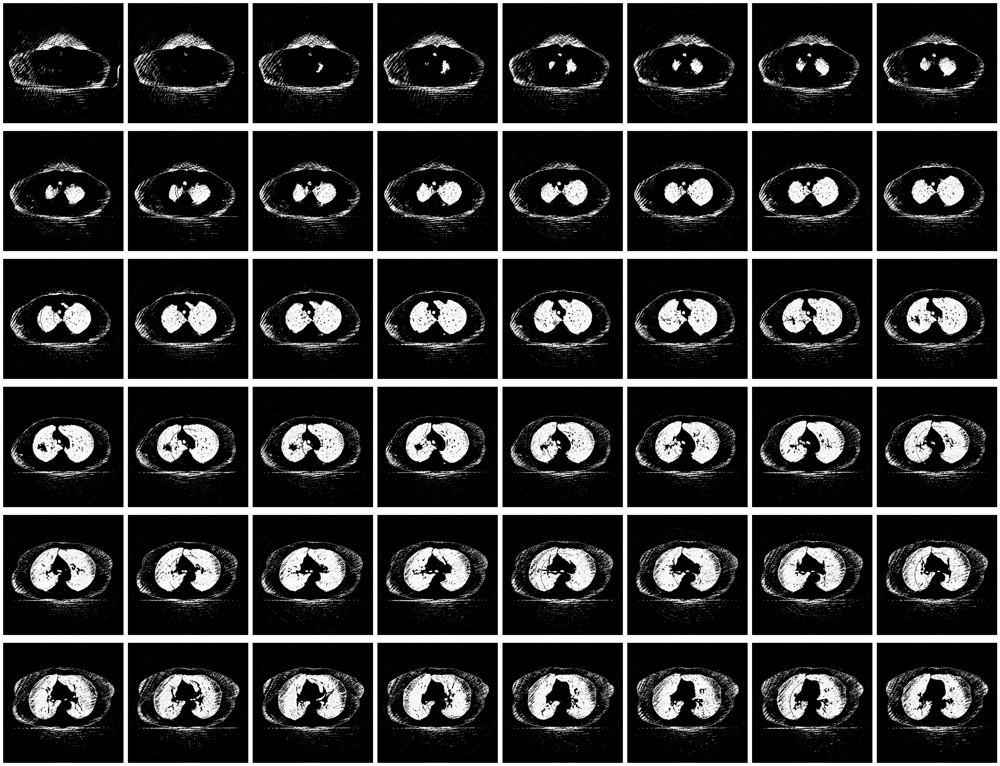

In [4]:
min_index = 0
max_index = 50 # 16 * 8
timestamp = 5

fig, axes = plt.subplots((max_index-min_index) // 8, 8, figsize=(32, (max_index-min_index) // 2))
fig.subplots_adjust(hspace=0, wspace=0.1)  # サブプロット間のスペースを調整

for i in range((max_index-min_index) // 8):
    for j in range(8):
        ax = axes[i, j]
        ax.imshow(x[timestamp, min_index + i * 8 + j], cmap='gray', aspect=1)
        ax.axis('off')

plt.tight_layout()
plt.show()


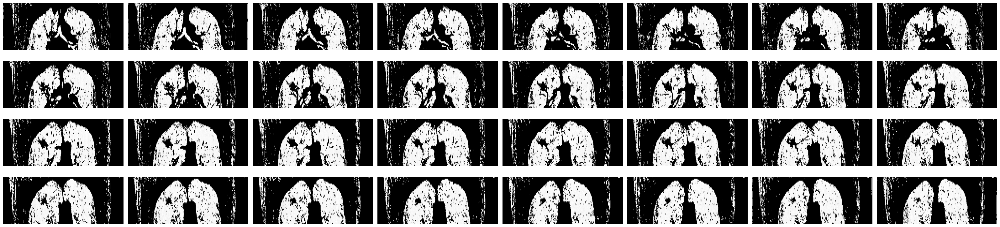

In [5]:
min_index = 15 * 16
max_index = 17 * 16
timestamp = 5

fig, axes = plt.subplots((max_index-min_index) // 8, 8, figsize=(32, (max_index-min_index) // 4))
fig.subplots_adjust(hspace=0, wspace=0.1)  # サブプロット間のスペースを調整

for i in range((max_index-min_index) // 8):
    for j in range(8):
        ax = axes[i, j]
        ax.imshow(x[timestamp, :, min_index + i * 8 + j], cmap='gray', aspect=4)
        ax.axis('off')

plt.tight_layout()
plt.show()


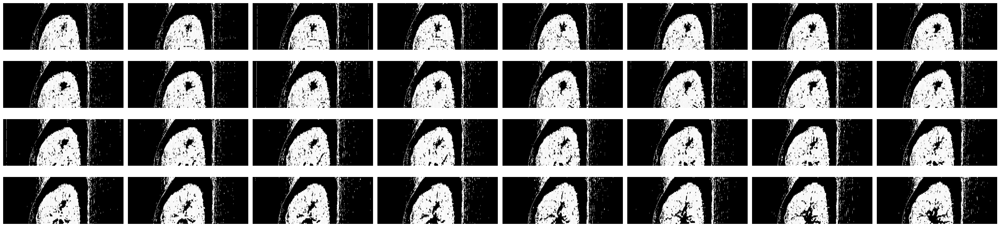

In [6]:
min_index = 10 * 16
max_index = 12 * 16
timestamp = 5

fig, axes = plt.subplots((max_index-min_index) // 8, 8, figsize=(32, (max_index-min_index) // 4))
fig.subplots_adjust(hspace=0, wspace=0.1)  # サブプロット間のスペースを調整

for i in range((max_index-min_index) // 8):
    for j in range(8):
        ax = axes[i, j]
        ax.imshow(x[timestamp, :, :, min_index + i * 8 + j], cmap='gray', aspect=4)
        ax.axis('off')

plt.tight_layout()
plt.show()


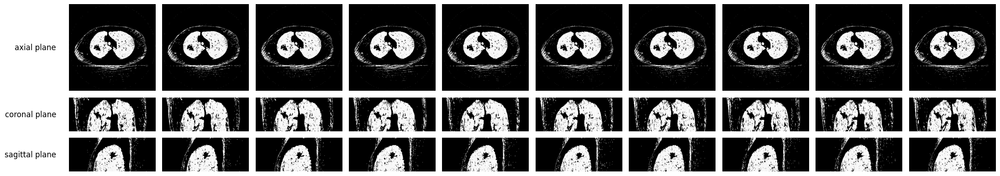

In [7]:
fig = plt.figure(figsize=(22, 4))
gs = gridspec.GridSpec(3, 10, height_ratios=[512, 200, 200])

axial = 24
coronal = 256
sagittal = 168

for t in range(10):
    ax = fig.add_subplot(gs[0, t])
    ax.imshow(x[t, axial], cmap='gray')
    ax.set_xticks([])
    ax.set_yticks([])
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    if t == 0:
        ax.set_ylabel('axial plane', rotation=0, ha='right', va='center', size='large', labelpad=20) 

    ax = fig.add_subplot(gs[1, t])
    ax.imshow(x[t, :, coronal], cmap='gray', aspect=4)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    if t == 0:
        ax.set_ylabel('coronal plane', rotation=0, ha='right', va='center', size='large', labelpad=20) 

    ax = fig.add_subplot(gs[2, t])
    ax.imshow(x[t, :, :, sagittal], cmap='gray', aspect=4)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    if t == 0:
        ax.set_ylabel('sagittal plane', rotation=0, ha='right', va='center', size='large', labelpad=20)


plt.tight_layout()
plt.show()


In [3]:
import sys
sys.path.append("..")

In [4]:
import os
from pathlib import Path

import torch
import matplotlib.pyplot as plt
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torchvision import transforms
from hrdae.models.networks import create_network, HRDAE2dOption, RAE2dOption
from hrdae.models.networks.motion_encoder import MotionConv2dEncoder1dOption, MotionNormalEncoder1dOption
from hrdae.dataloaders.datasets import create_dataset, SlicedCTDatasetOption
from hrdae.dataloaders.transforms import create_transform, MinMaxNormalizationOption, Pool2dOption

In [5]:
dataset = create_dataset(
    opt=SlicedCTDatasetOption(
        sequential=True,
        root=Path("../data"),
        slice_index=[24, 40],
        in_memory=False,
        content_phase="random",
        motion_phase="0",
        motion_aggregation="none",
        slice_axis="y",
        slice_range=[24, 40],
    ),
    transform=transforms.Compose([
        create_transform(Pool2dOption([2, 2])),
        create_transform(MinMaxNormalizationOption()),
    ]),
    is_train=False,
)

In [6]:
len(dataset)

2272

In [6]:
loader = DataLoader(dataset=dataset, batch_size=8, shuffle=True)

In [15]:
def get_opt_and_label_by_name_and_loss(name: str):
    if name == "sct-hrdae2d-conv2d":
        opt = HRDAE2dOption(
            activation="sigmoid",
            hidden_channels=64,
            latent_dim=32,
            conv_params=[{"kernel_size": [3], "stride": [2], "padding": [1], "output_padding": [1]}] * 3,
            motion_encoder=MotionConv2dEncoder1dOption(
                in_channels=2,
                hidden_channels=64,
                latent_dim=32,
                conv_params=[{"kernel_size": [3], "stride": [1, 2], "padding": [1], "output_padding": [0, 1]}] * 3,
                deconv_params=[{
                    "kernel_size": [3],
                    "stride": [2],
                    "padding": [1],
                }] * 3,
            ),
            upsample_size=[8, 8],
            in_channels=1,
            aggregator="concatenation",
            cycle=False,
            connection_aggregation="concatenation",
        )
        label = "HD-VRN"
    elif name == "sct-rae2d-conv2d":
        opt = RAE2dOption(
            activation="sigmoid",
            hidden_channels=64,
            latent_dim=32,
            conv_params=[{"kernel_size": [3], "stride": [2], "padding": [1], "output_padding": [1]}] * 3,
            motion_encoder=MotionConv2dEncoder1dOption(
                in_channels=2,
                hidden_channels=64,
                latent_dim=32,
                conv_params=[{"kernel_size": [3], "stride": [1, 2], "padding": [1], "output_padding": [0, 1]}] * 3,
                deconv_params=[{"kernel_size": [3], "stride": [2], "padding": [1], "output_padding": [1]}] * 3,
            ),
            upsample_size=[8, 8],
        )
        label = "Normal AutoEncoder with TPM"
    elif name == "sct-rae2d-normal1d":
        opt = RAE2dOption(
            activation="sigmoid",
            hidden_channels=64,
            latent_dim=32,
            conv_params=[{"kernel_size": [3], "stride": [2], "padding": [1], "output_padding": [1]}] * 3,
            motion_encoder=MotionNormalEncoder1dOption(
                in_channels=2,
                hidden_channels=64,
                latent_dim=32,
                conv_params=[{"kernel_size": [3], "stride": [2], "padding": [1], "output_padding": [1]}] * 3,
                deconv_params=[{"kernel_size": [3], "stride": [2], "padding": [1], "output_padding": [1]}] * 3,
            ),
            upsample_size=[8, 8],
        )
        label = "Normal AutoEncoder"
    else:
        raise KeyError(name)
    
    return opt, label


In [7]:
import numpy as np
from tqdm import tqdm


def save_reconstructions(paths: list[str]):
    for i, data in tqdm(enumerate(loader), total=len(loader)):
        xp = data["xp"]
        xm = data["xm"]
        xm_0 = data["xm_0"]
        xp_0 = data["xp_0"]

        ys = {}
        ys["ground_truth"] = xp
        
        for path in paths:
            dirname = path.split("results/finalized/")[1]
            name = dirname.split("/")[0]

            opt, label = get_opt_and_label_by_name_and_loss(name)

            net = create_network(1, opt)
            net.load_state_dict(torch.load(path))
            net.eval()

            y, _, _, _ = net(xm, xp_0, xm_0)
            ys[label.lower().replace(" ", "_")] = y.clone().detach().numpy()
        
        np.savez(f"./data/sct_{i}", **ys)

        # n = len(ys)
        # m = 10
        # fig, axes = plt.subplots(n, m, figsize=(m * 2, n * 1))  # 画像サイズに合わせて調整
        # fig.subplots_adjust(hspace=0, wspace=0.1)  # サブプロット間のスペースを調整

        # for ni in range(n):
        #     y = ys[ni]
        #     for mi in range(m):
        #         ax = axes[ni, mi]
        #         ax.imshow(y[0, mi, 0], cmap='gray', aspect=0.5)  # グレースケールで表示
        #         # ax.axis('off')  # 軸を非表示にする
        #         ax.set_xticks([])
        #         ax.set_yticks([])
        #         ax.spines['top'].set_visible(False)
        #         ax.spines['right'].set_visible(False)
        #         ax.spines['left'].set_visible(False)
        #         ax.spines['bottom'].set_visible(False)
        #     axes[ni, 0].set_ylabel(labels[ni], rotation=0, ha='right', va='center', size='large', labelpad=20) 

        # fig.tight_layout()
        # plt.show()


In [58]:
save_reconstructions(
    paths=[
        # "../results/finalized/sct-hrdae2d-conv2d/1/2024-07-13_04-42-49/weights/best_model.pth",
        "../results/finalized/sct-hrdae2d-conv2d/2/2024-07-15_19-54-06/weights/best_model.pth",
        "../results/finalized/sct-rae2d-conv2d/2024-07-16_16-05-43/weights/best_model.pth",
        "../results/finalized/sct-rae2d-normal1d/2024-07-16_17-08-40/weights/best_model.pth",
    ],
)

100%|██████████| 284/284 [04:35<00:00,  1.03it/s]


In [8]:
labels = {
    0: ("hd-vrn", "HD-VRN"),
    1: ("normal_autoencoder_with_tpm", "Normal Autoencoder with TPM"),
    2: ("normal_autoencoder", "Normal Autoencoder"),
}

In [9]:
def show_reconstructions(path, j):
    data = np.load(path)
    n = 2 * len(data)
    m = 10
    fig, axes = plt.subplots(n-1, m, figsize=(m*4, n*2-3))  # 画像サイズに合わせて調整
    fig.subplots_adjust(hspace=0, wspace=0.1)  # サブプロット間のスペースを調整

    for mi in range(m):
        ax = axes[0, mi]
        ax.imshow(data["ground_truth"][j, mi, 0], cmap='gray', aspect=0.5)  # グレースケールで表示
        # ax.axis('off')  # 軸を非表示にする
        ax.set_xticks([])
        ax.set_yticks([])
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['left'].set_visible(False)
        ax.spines['bottom'].set_visible(False)

    axes[0, 0].set_ylabel("Ground Truth", rotation=0, ha='right', va='center', labelpad=20, fontsize=20) 

    for ni in range(len(data) - 1):
        key, name = labels[ni]
        y = data[key]
        for mi in range(m):
            ax = axes[ni*2+1, mi]
            ax.imshow(y[j, mi, 0], cmap='gray', aspect=0.5)  # グレースケールで表示
            # ax.axis('off')  # 軸を非表示にする
            ax.set_xticks([])
            ax.set_yticks([])
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
        for mi in range(m):
            ax = axes[ni*2+2, mi]
            z = y - data["ground_truth"]
            z[(z > -0.1) & (z < 0.1)] = 0
            ax.imshow(z[j, mi, 0], aspect=0.5)  # グレースケールで表示
            # ax.axis('off')  # 軸を非表示にする
            ax.set_xticks([])
            ax.set_yticks([])
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
        name = name.replace(" with", "\nwith")
        axes[ni*2+1, 0].set_ylabel(name, rotation=0, ha='right', va='center',  labelpad=20, fontsize=20) 
        axes[ni*2+2, 0].set_ylabel(name + " (diff)", rotation=0, ha='right', va='center', labelpad=20, fontsize=20) 

    fig.tight_layout()
    plt.show()

    return


In [10]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


def display_reconstrutions(path, i):
    data = np.load(path)
    fig, axes = plt.subplots(2, 2, figsize=(10, 5))
    fig.subplots_adjust(hspace=0, wspace=0.1)  # サブプロット間のスペースを調整

    im1 = axes[0, 0].imshow(data["ground_truth"][i, 0, 0], cmap='gray', aspect=0.5)
    im2 = axes[0, 1].imshow(data["hd-vrn"][i, 0, 0], cmap='gray', aspect=0.5)
    im3 = axes[1, 0].imshow(data["normal_autoencoder"][i, 0, 0], cmap='gray', aspect=0.5)
    im4 = axes[1, 1].imshow(data["normal_autoencoder_with_tpm"][i, 0, 0], cmap='gray', aspect=0.5)

    for x in range(2):
        for y in range(2):
            axes[x, y].axis("off")

    def update(frame_number):
        im1.set_array(data["ground_truth"][i, frame_number, 0])
        im2.set_array(data["hd-vrn"][i, frame_number, 0])
        im3.set_array(data["normal_autoencoder"][i, frame_number, 0])
        im4.set_array(data["normal_autoencoder_with_tpm"][i, frame_number, 0])
        return [im1, im2, im3, im4]
    
    anim = FuncAnimation(
        fig, update, frames=10, interval=100, blit=True,
    )

    return anim

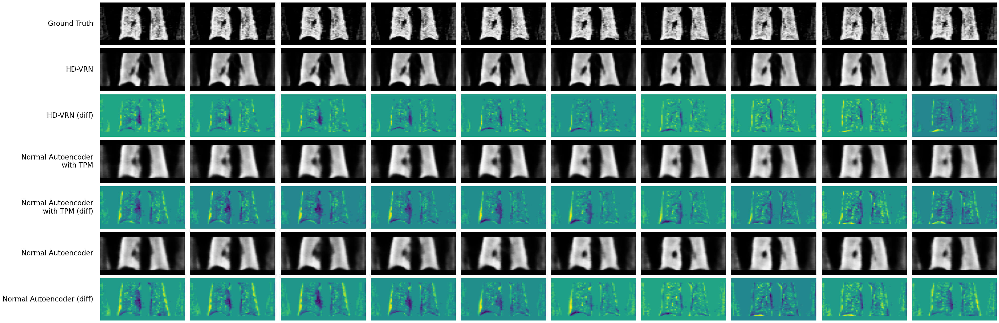

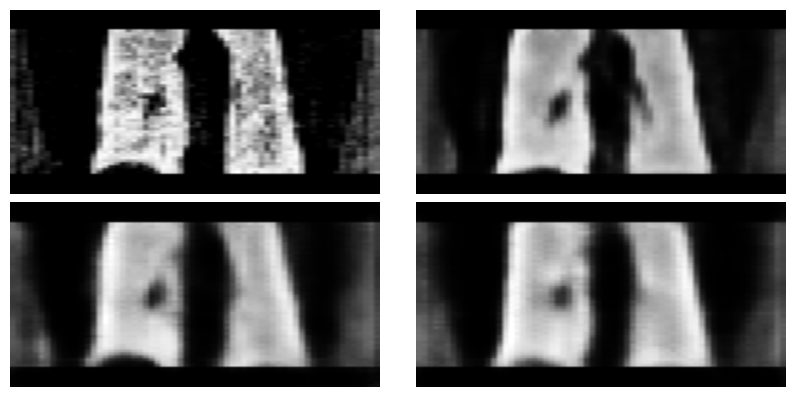

In [11]:
show_reconstructions("./data/sct_101.npz", 5)  # がんが明瞭
HTML(display_reconstrutions("./data/sct_101.npz", 5).to_jshtml())

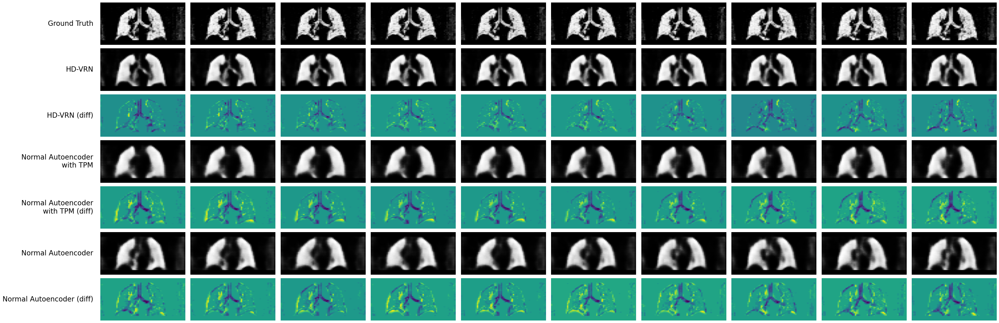

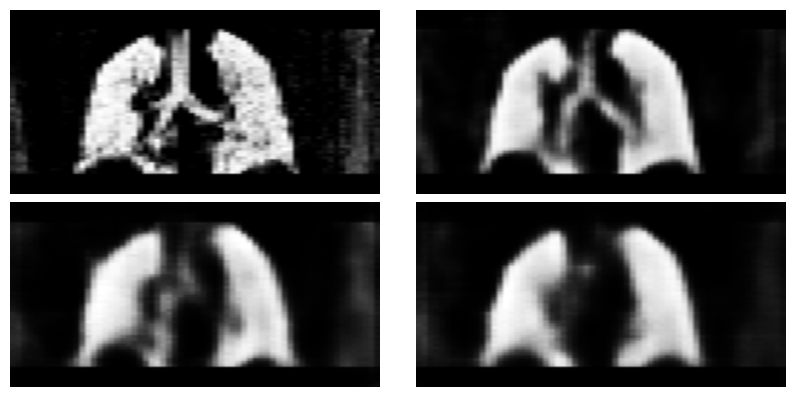

In [12]:
show_reconstructions("./data/sct_126.npz", 3) 
HTML(display_reconstrutions("./data/sct_126.npz", 3).to_jshtml())

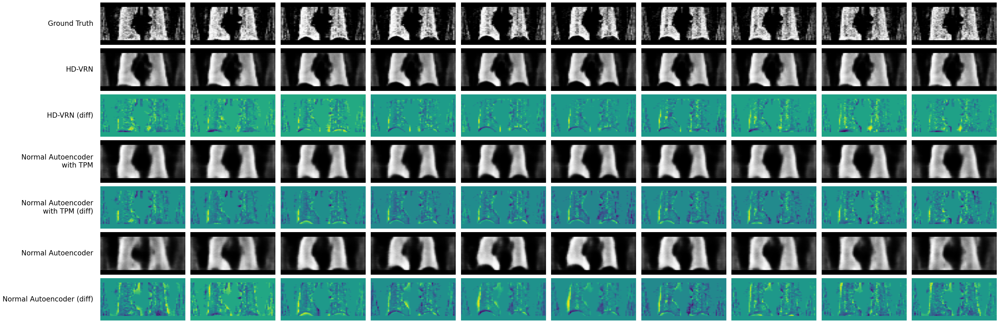

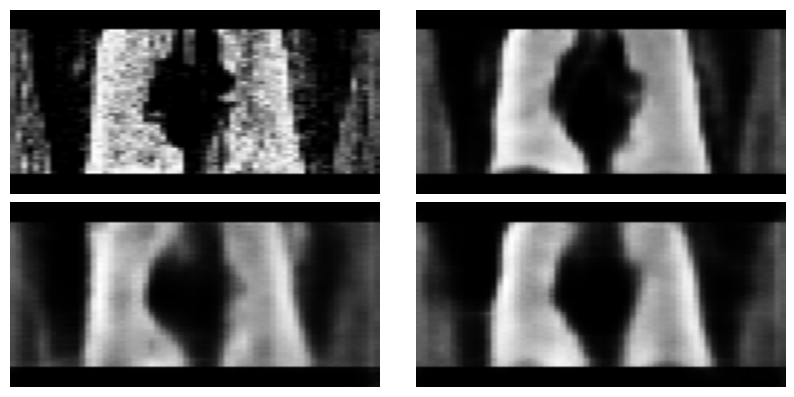

In [13]:
show_reconstructions("./data/sct_130.npz", 0) 
HTML(display_reconstrutions("./data/sct_130.npz", 0).to_jshtml())

In [82]:
from glob import glob

# for i, path in enumerate(sorted(glob("./data/*.npz"))):
#     if i < 36:
#         continue
#     elif i > 42:
#         break
# 
#     for j in range(8):
#         print(path, j)
#         show_reconstructions(path, j)


In [24]:
# 動画ごとのMSE

def calc_mse(paths: list[str]):
    d = {}
    for path in paths:
        dirname = path.split("results/finalized/")[1]
        name = dirname.split("/")[0]

        opt, label = get_opt_and_label_by_name_and_loss(name)

        net = create_network(1, opt)
        net.load_state_dict(torch.load(path))
        net.eval()
        net.cuda()

        results = []

        for data in loader:
            y, _, _, _ = net(data["xm"].cuda(), data["xp_0"].cuda(), data["xm_0"].cuda())
            results.append(F.mse_loss(y, data["xp"].cuda()).item())
        
        d[label] = results

    return d


In [25]:
result_dict = calc_mse(
    paths=[
        "../results/finalized/sct-hrdae2d-conv2d/1/2024-07-13_04-42-49/weights/best_model.pth",
        "../results/finalized/sct-hrdae2d-conv2d/2/2024-07-15_19-54-06/weights/best_model.pth",
        "../results/finalized/sct-rae2d-conv2d/2024-07-16_16-05-43/weights/best_model.pth",
        "../results/finalized/sct-rae2d-normal1d/2024-07-16_17-08-40/weights/best_model.pth",
    ],
)

/home/nakai-yu/dev/D-3DVRVAE/.venv/lib/python3.12/site-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
/home/nakai-yu/dev/D-3DVRVAE/.venv/lib/python3.12/site-packages/torch/nn/modules/conv.py:952: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv_transpose2d(
/home/nakai-yu/dev/D-3DVRVAE/.venv/lib/python3.12/site-packages/torch/nn/modules/conv.py:306: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Trig

In [26]:
import json
with open('./sct.json', 'w') as f:
    json.dump(result_dict, f, indent=2)


In [27]:
import numpy as np

for k, v in result_dict.items():
    print(k, "mse", np.mean(v), "stderr", np.std(v))

HD-VRN mse 0.015631273790577452 stderr 0.004499448018616013
Normal AutoEncoder with TPM mse 0.01714028438067877 stderr 0.004160294961389256
Normal AutoEncoder mse 0.017399666712842356 stderr 0.004319525705300909
